In [1]:
#Optional, change the paths below if you are not running from drive!
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Install detectron2

In [2]:
!python -m pip install pyyaml==5.1
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities.
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

# Properly install detectron2. (Please do not install twice in both ways)
# !python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 KB 18.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pyyaml: filename=PyYAML-5.1-cp38-cp38-linux_x86_64.whl size=44089 sha256=9c547e43e2c3b37a4c67b8858c8bfd009f21f35be3e8228dc65c9ffcc4d43251
  Stored in directory: /root/.cache/pip/wheels/52/dd/2b/10ff8b0ac81b93946bb5fb9e6749bae2dac246506c8774e6cf
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 6.0
    Uninstalling PyYAML-6.0:
      Successfully uninstalled PyYAML-6.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
dask 2022.2.1 requires pyyaml>=5.3.1, but you have pyyaml 5.1 which is incompatible.
Cloning into 'detectron2'...
remote: Enumerating objects: 14750, done.
remote: Cou

In [3]:
sys.path.insert(0, os.path.abspath('./detectron2'))
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2021 NVIDIA Corporation
Built on Sun_Feb_14_21:12:58_PST_2021
Cuda compilation tools, release 11.2, V11.2.152
Build cuda_11.2.r11.2/compiler.29618528_0
torch:  1.13 ; cuda:  cu116
detectron2: 0.6


In [4]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

# Train on a custom dataset

In this section, we show how to train an existing detectron2 model on a custom dataset in a new format.

We use [the balloon segmentation dataset](https://github.com/matterport/Mask_RCNN/tree/master/samples/balloon)
which only has one class: balloon.
We'll train a balloon segmentation model from an existing model pre-trained on COCO dataset, available in detectron2's model zoo.

Note that COCO dataset does not have the "balloon" category. We'll be able to recognize this new class in a few minutes.

## Prepare the dataset

In [7]:
from detectron2.data.datasets import register_coco_instances

dir = '/content/drive/MyDrive/ComputerVision-Detectron/'

register_coco_instances("strawberries", {}, 
                        f"{dir}annotations_coco.json", 
                        f"{dir}images") #TRAIN


fruits_nuts_metadata = MetadataCatalog.get("strawberries")
dataset_dicts = DatasetCatalog.get("strawberries")

AssertionError: ignored

In [6]:
register_coco_instances("strawberries_val", {}, 
                        f"{dir}annotations_coco_val.json", 
                        f"{dir}images") # VALIDATION

## Train!

Now, let's fine-tune a COCO-pretrained R50-FPN Mask R-CNN model on the balloon dataset. It takes ~2 minutes to train 300 iterations on a P100 GPU.


In [8]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.merge_from_file('./detectron2/configs/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml')
#cfg.merge_from_file('./detectron2/configs/COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml')
cfg.DATASETS.TRAIN = ("strawberries",)
cfg.DATASETS.TEST = ("strawberries_val",)
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = "detectron2://COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl"  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2  # This is the real "batch size" commonly known to deep learning people
cfg.SOLVER.BASE_LR = 0.025  # pick a good LR
cfg.SOLVER.MAX_ITER = 100    # 300 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
cfg.SOLVER.STEPS = []        # do not decay learning rate
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # The "RoIHead batch size". 128 is faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3  # only has one class (ballon). (see https://detectron2.readthedocs.io/tutorials/datasets.html#update-the-config-for-new-datasets)
# NOTE: this config means the number of classes, but a few popular unofficial tutorials incorrect uses num_classes+1 here.
cfg.CUDA_LAUNCH_BLOCKING=1


os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[01/11 05:14:37 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f10217.pkl: 178MB [00:18, 9.52MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[01/11 05:15:00 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.8/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3190.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[01/11 05:15:23 d2.utils.events]:  eta: 0:00:55  iter: 19  total_loss: 2  loss_cls: 0.6353  loss_box_reg: 0.7857  loss_mask: 0.4417  loss_rpn_cls: 0.04937  loss_rpn_loc: 0.0245  time: 0.7017  data_time: 0.2995  lr: 0.0047703  max_mem: 2334M
[01/11 05:15:35 d2.utils.events]:  eta: 0:00:38  iter: 39  total_loss: 1.086  loss_cls: 0.3206  loss_box_reg: 0.4718  loss_mask: 0.2032  loss_rpn_cls: 0.03814  loss_rpn_loc: 0.04254  time: 0.6559  data_time: 0.2206  lr: 0.0097653  max_mem: 2334M
[01/11 05:15:44 d2.utils.events]:  eta: 0:00:23  iter: 59  total_loss: 0.8728  loss_cls: 0.2579  loss_box_reg: 0.3999  loss_mask: 0.1631  loss_rpn_cls: 0.01202  loss_rpn_loc: 0.0289  time: 0.5753  data_time: 0.0096  lr: 0.01476  max_mem: 2334M
[01/11 05:15:52 d2.utils.events]:  eta: 0:00:09  iter: 79  total_loss: 1.041  loss_cls: 0.3046  loss_box_reg: 0.4627  loss_mask: 0.21  loss_rpn_cls: 0.0173  loss_rpn_loc: 0.04085  time: 0.5322  data_time: 0.0078  lr: 0.019755  max_mem: 2334M
[01/11 05:16:02 d2.utils.ev

In [9]:
from detectron2.utils.visualizer import ColorMode

import random
cfg.MODEL.WEIGHTS = os.path.join("/content/drive/MyDrive/ComputerVision-Detectron/", "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
cfg.DATASETS.TEST = ("strawberries_val", )
predictor = DefaultPredictor(cfg)
dataset_dicts = DatasetCatalog.get("strawberries_val")
fruits_nuts_metadata = MetadataCatalog.get("strawberries_val")

[01/11 05:16:26 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ComputerVision-Detectron/model_final.pth ...
[01/11 05:16:36 d2.data.datasets.coco]: Loaded 30 images in COCO format from /content/drive/MyDrive/ComputerVision-Detectron/annotations_coco_val.json


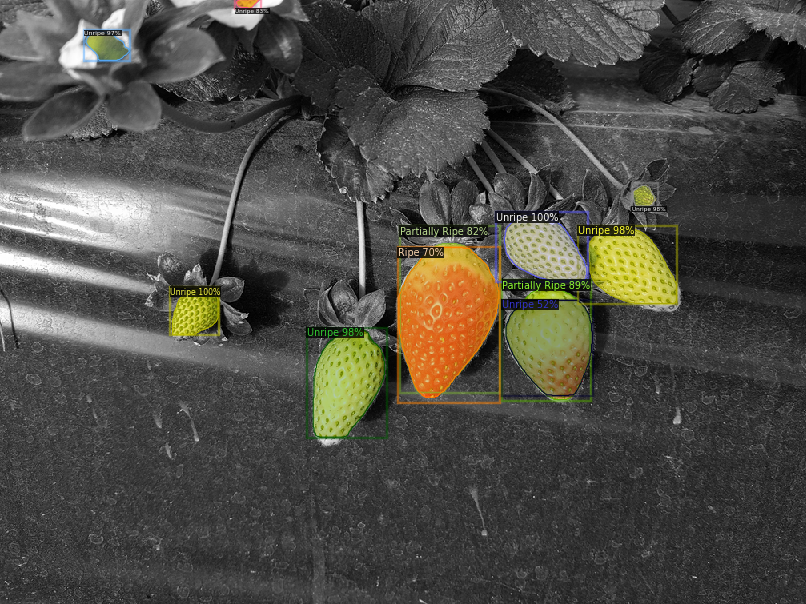

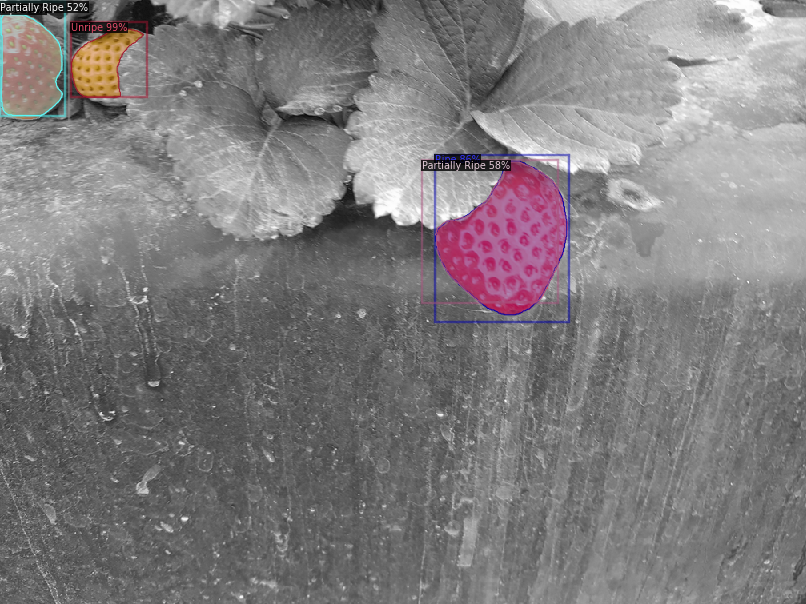

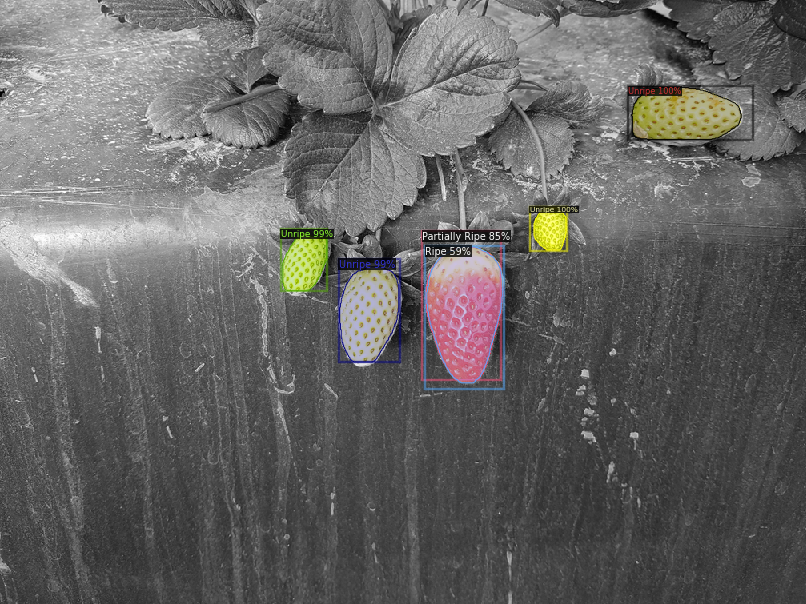

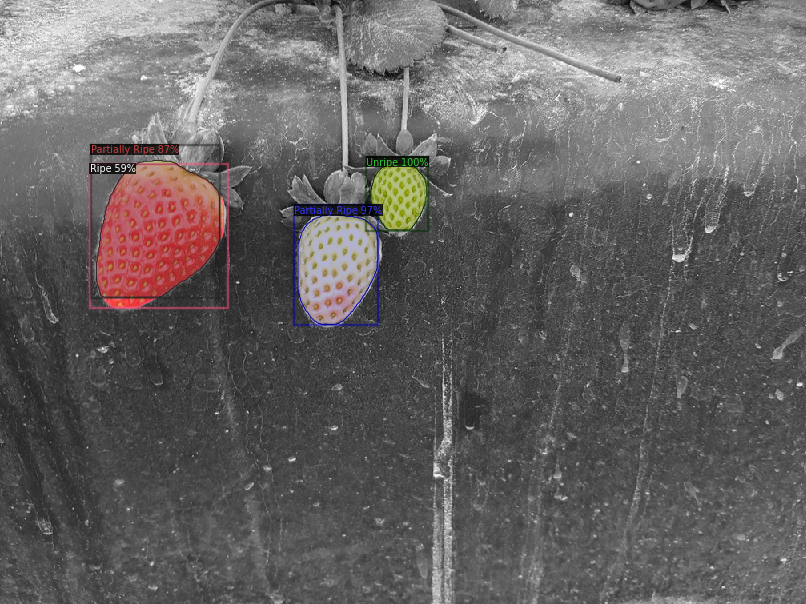

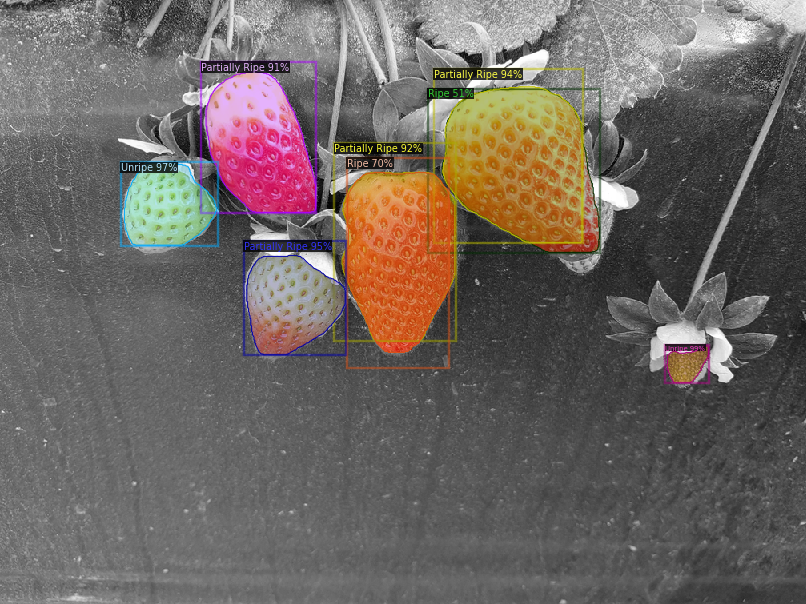

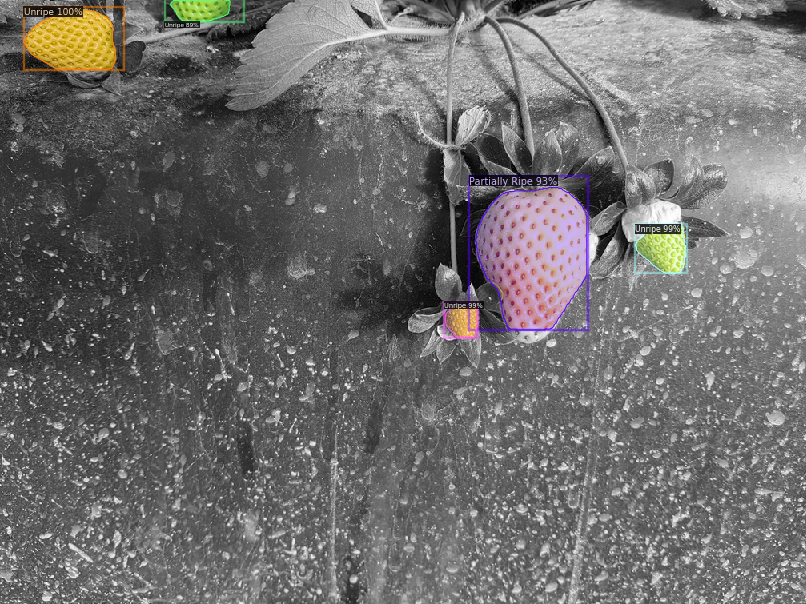

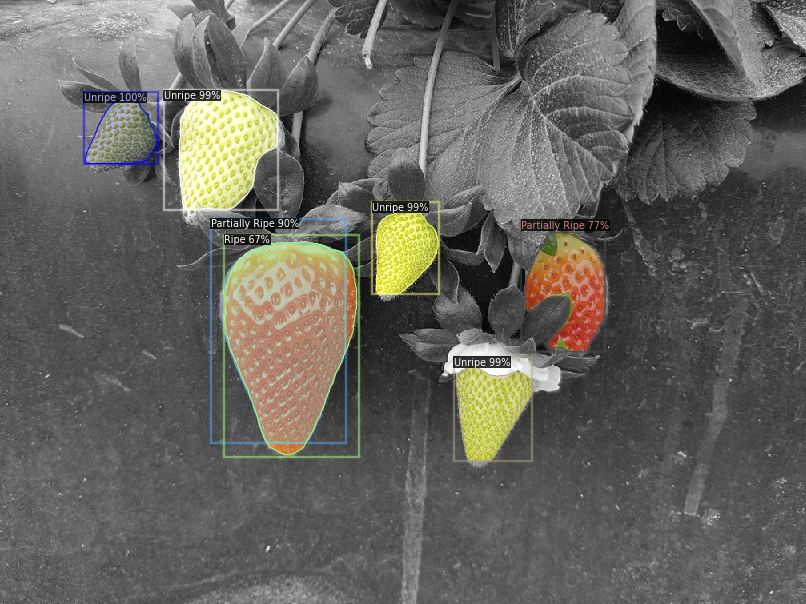

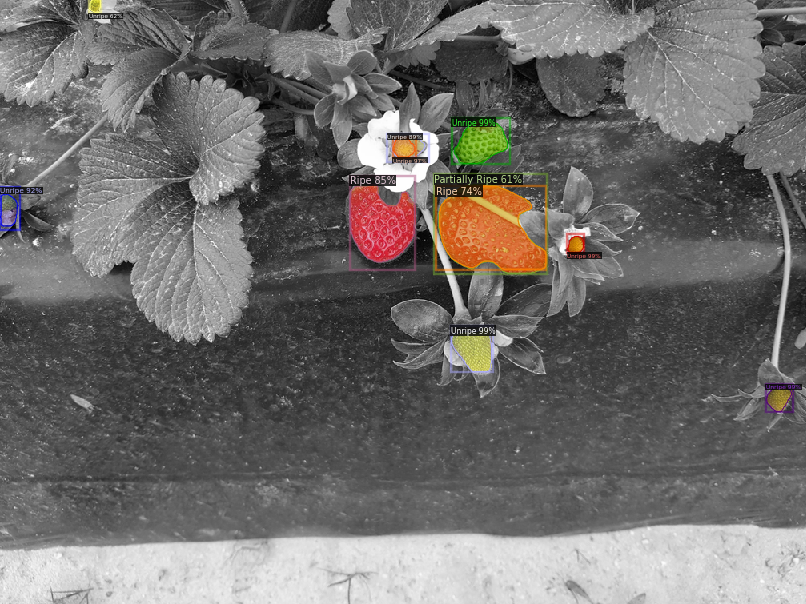

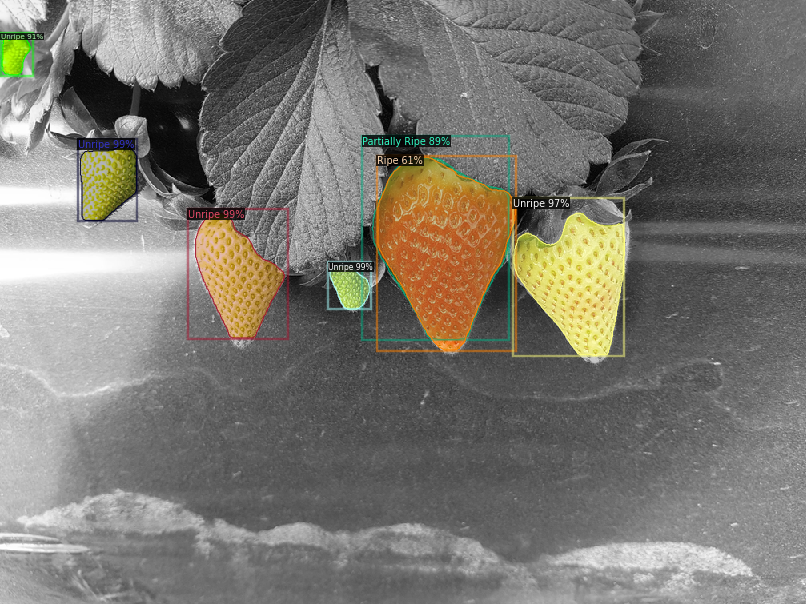

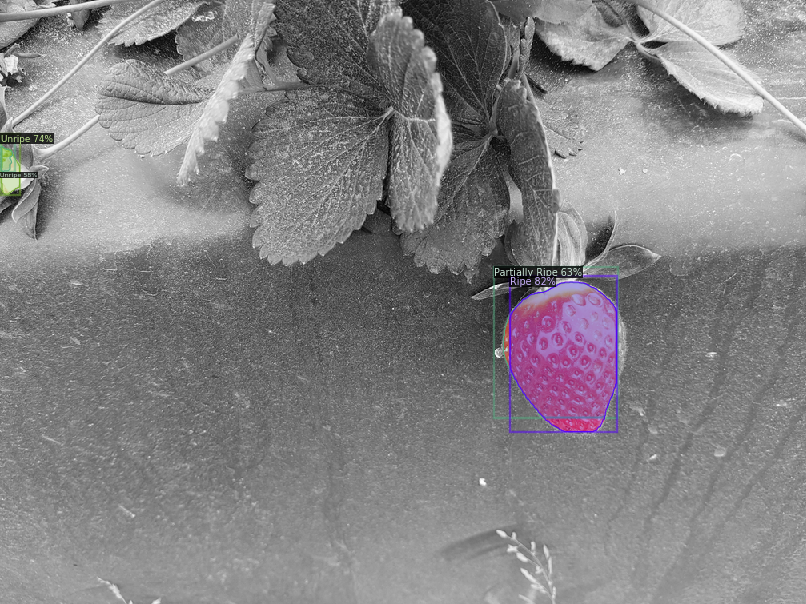

In [10]:
# SAMPLES EXTRACTED FROM VALIDATION
for d in random.sample(dataset_dicts, 10):    

    im = cv2.imread(d["file_name"])

    outputs = predictor(im)

    v = Visualizer(im[:, :, ::-1],

                   metadata=fruits_nuts_metadata,

                   scale=0.8,

                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels

    )

    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))

    cv2_imshow(v.get_image()[:, :, ::-1])

[01/11 05:18:13 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ComputerVision-Detectron/model_final.pth ...


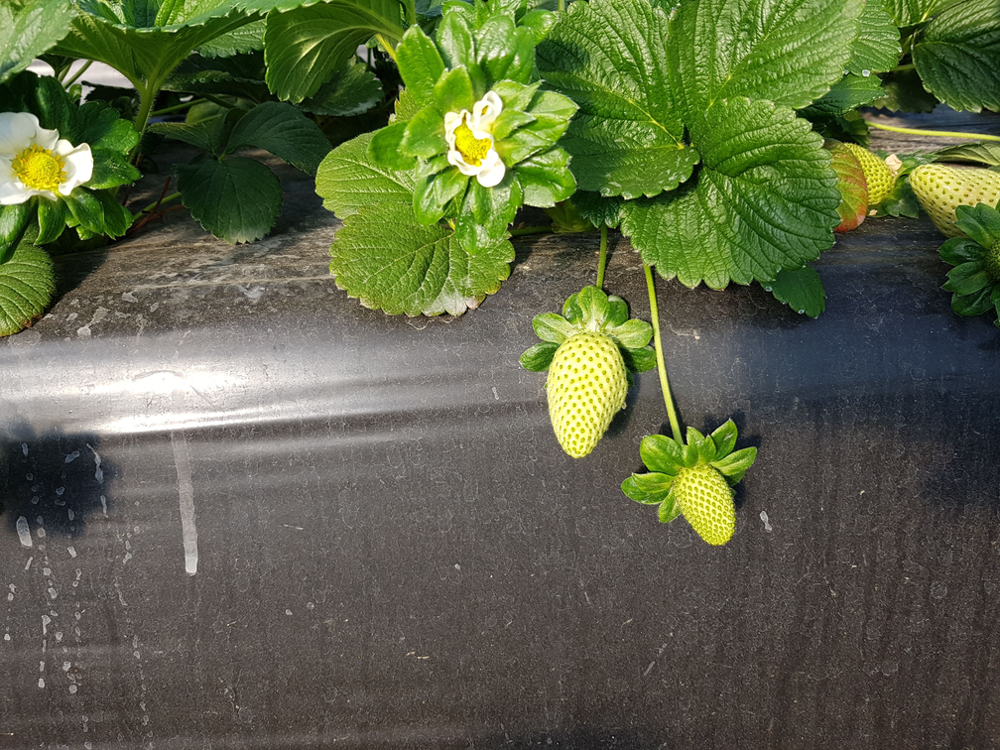

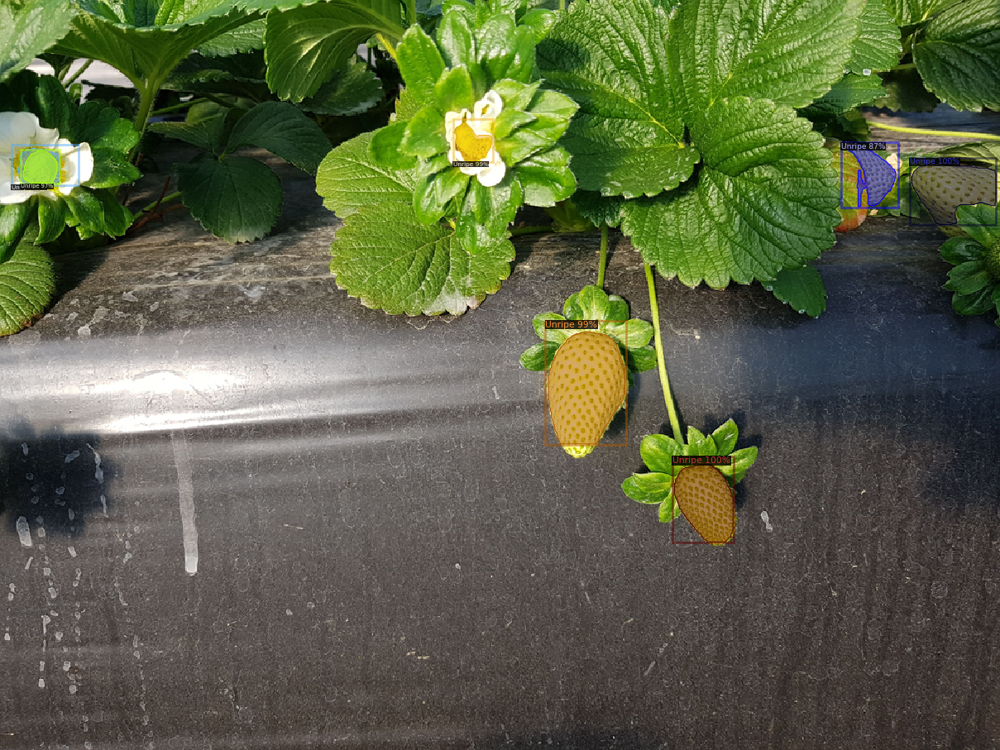

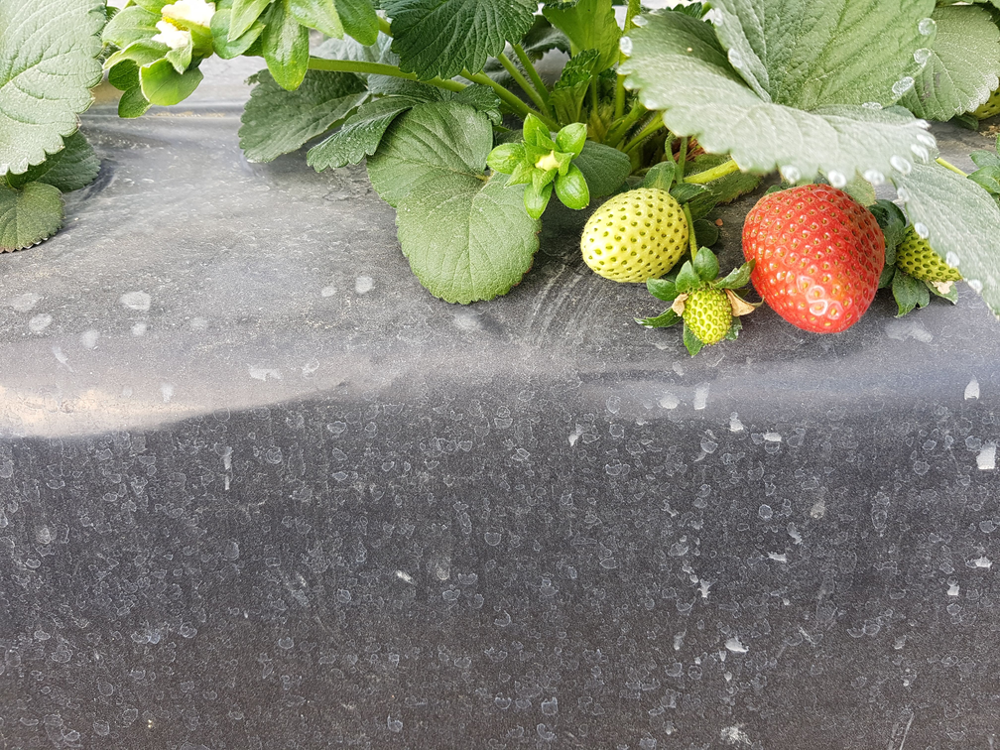

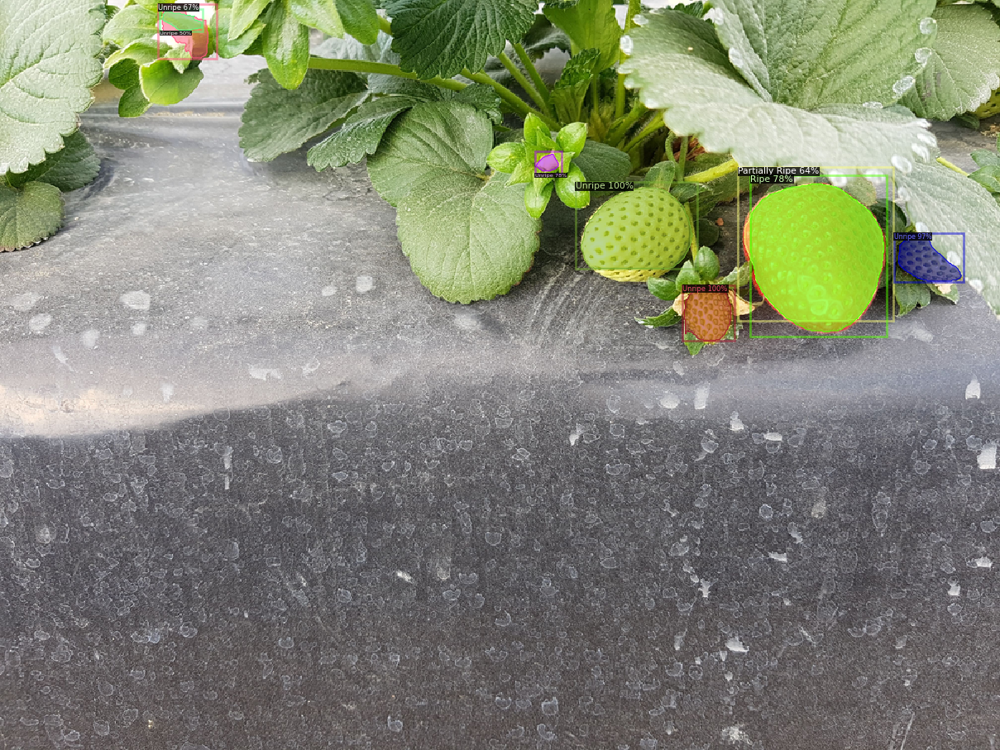

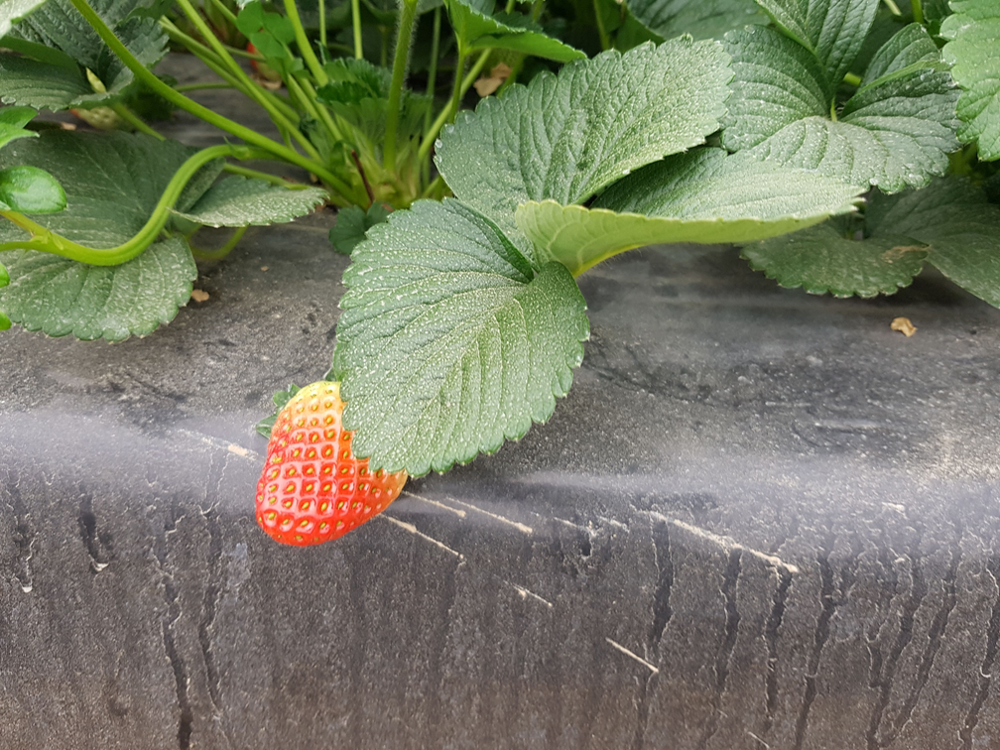

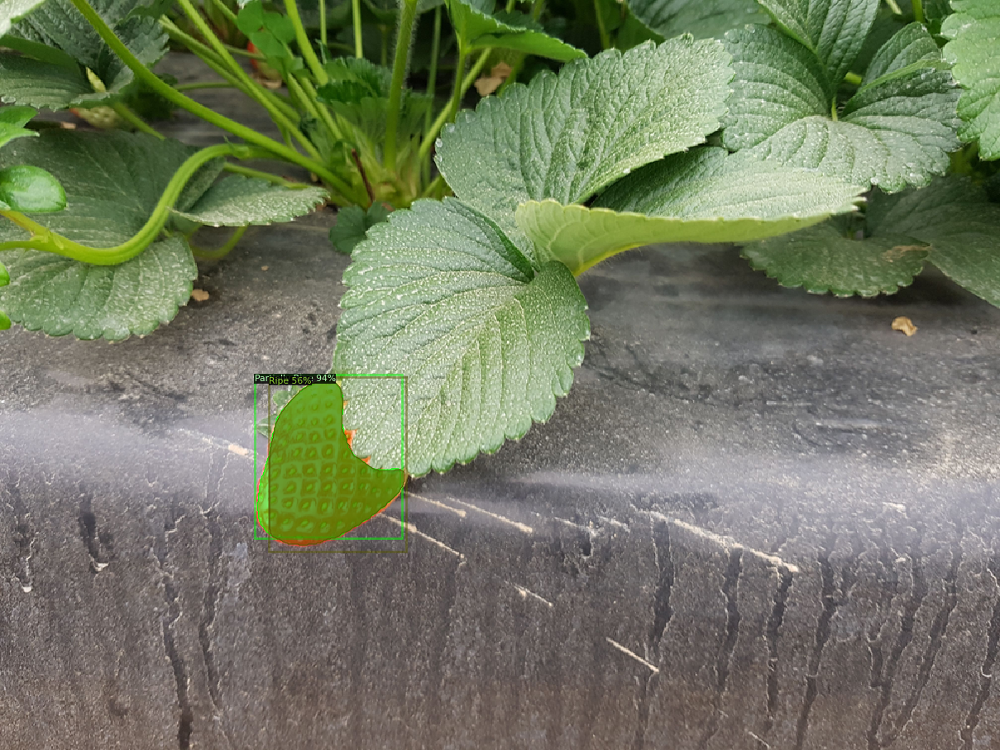

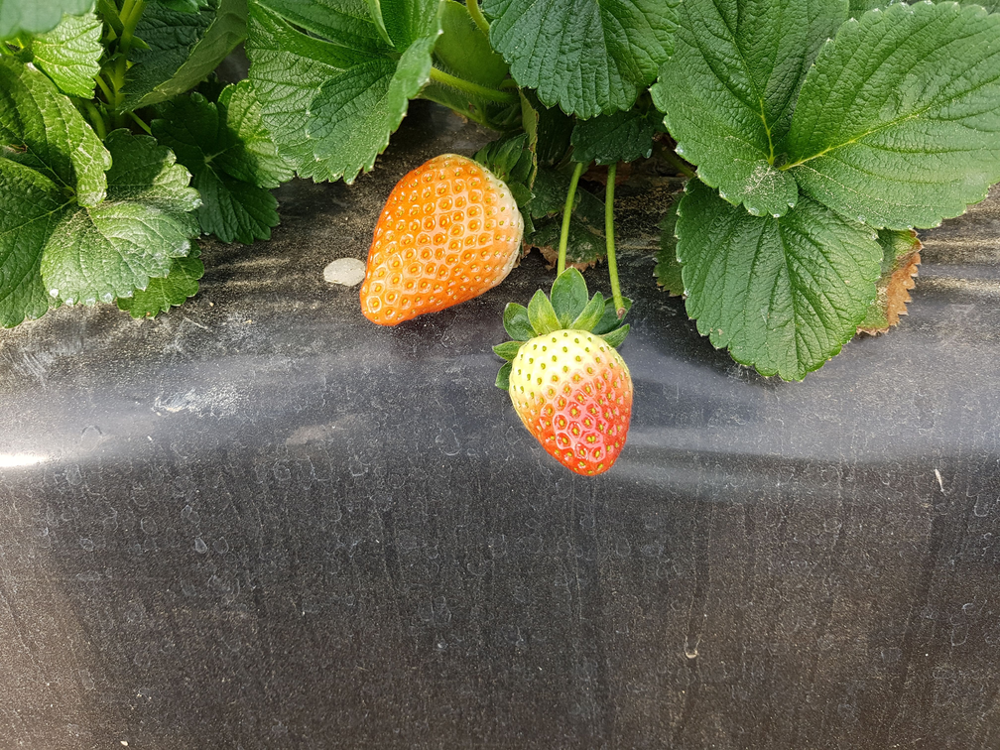

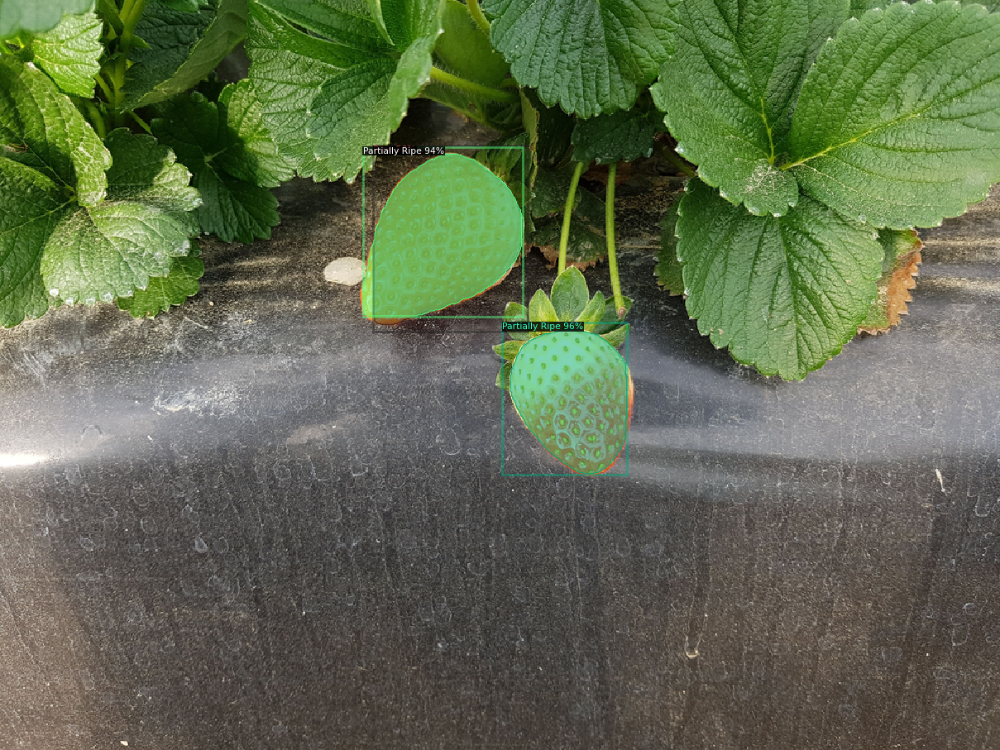

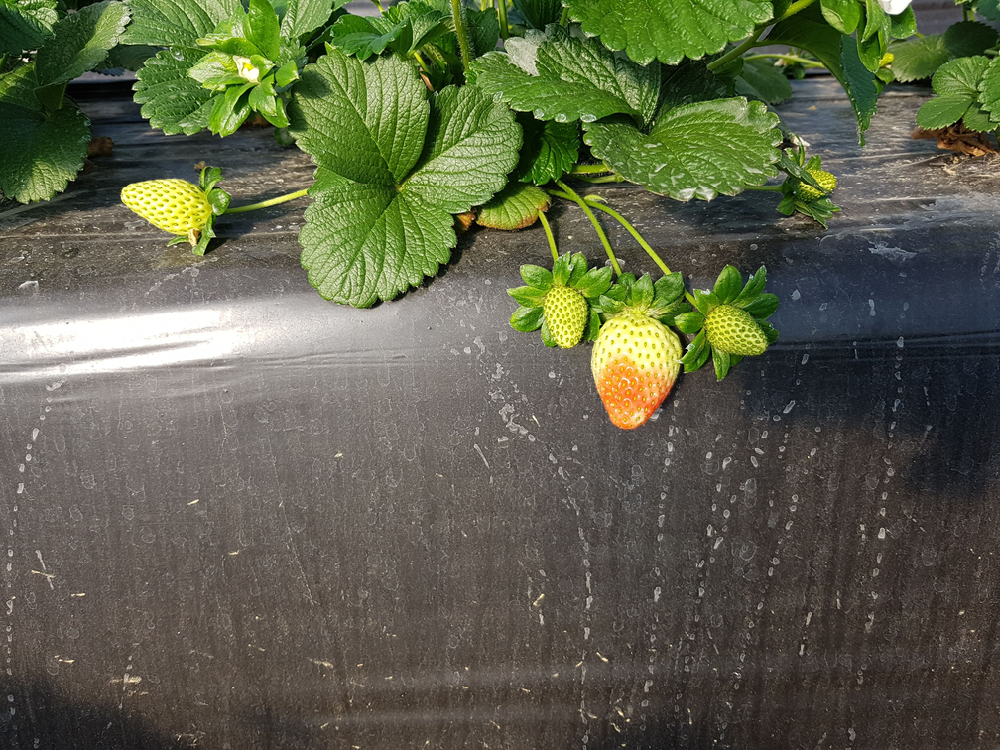

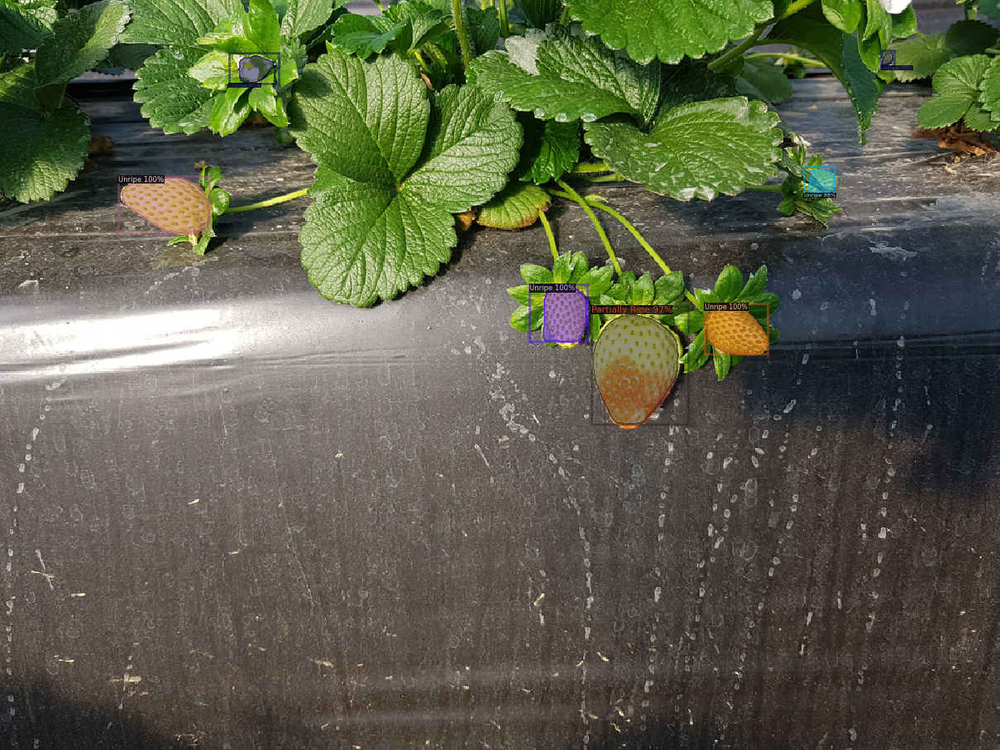

diff: 19.847315073013306


In [12]:
#PREDICTING ON GIVEN TEST IMAGES

import time
images = ["1002", "1029", "1099", "1104","1112"]
t = time.time()
predictor = DefaultPredictor(cfg)
for image_name in images:
  im = cv2.imread(f"/content/drive/MyDrive/ComputerVision-Detectron/validation/images/{image_name}.png")
  outputs = predictor(im)
  cv2_imshow(im)
  v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])
etime = time.time()
print("diff: {}".format(etime - t))

In [13]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

## Inference & evaluation using the trained model


In [ ]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

Then, we randomly select several samples to visualize the prediction results.

In [ ]:
from detectron2.utils.visualizer import ColorMode

for d in random.sample(dataset_dicts, 10):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                   metadata=fruits_nuts_metadata, 
                   scale=0.5, 
                   instance_mode=ColorMode.IMAGE   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

We can also evaluate its performance using AP metric implemented in COCO API.
This gives an AP of ~70. Not bad!

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("strawberries", output_dir="./output")
val_loader = build_detection_test_loader(cfg, "strawberries")
print(inference_on_dataset(predictor.model, val_loader, evaluator))
# another equivalent way to evaluate the model is to use `trainer.test`